# Astroworld Crowd Crush

##### General methods we will use

In [3]:
using LinearAlgebra, Plots, LaTeXStrings;
using SpecialFunctions: gamma, loggamma, zeta
function plus(x)
    return max(x, 0)
end

function minus(x)
    return max(-x, 0)
end

function create_D_vecs(u_vec, t_n, h) # returns Dplusminus and Dminusplus vectors
    Dplus = [diff(u_vec); 0] ./ h
    Dminus = [0; diff(u_vec)] ./ h
    Dplus[end] = (u_vec[1] - u_vec[end]) / h
    Dminus[1]= (u_vec[1] - u_vec[end]) / h 
    Dplusminus = minus.(Dplus)
    Dminusplus = plus.(Dminus)
    Dplusplus = plus.(Dplus)
    Dminusminus = minus.(Dminus)
    return C_H_func(2-t_n) .* (Dplusminus, Dminusplus, Dplusplus, Dminusminus)
end

function g_func(u_vec, t_n, h)
    (Dplusminus, Dminusplus, temp, temp) = create_D_vecs(u_vec, t_n, h)
    return C_H_func(2-t_n)*(Dplusminus .^2 + Dminusplus .^2)
end

function create_Dg_mat(v, t_n, N_h, h) # verified is correct
    (Dplusminus, Dminusplus, temp, temp) = create_D_vecs(v, t_n, h);
    Dg_mat = zeros(N_h, N_h)
    tridiag = Tridiagonal(-Dminusplus[2:end], Dplusminus + Dminusplus, -Dplusminus[1:end-1])
    Dg_mat[1, N_h] = -Dminusplus[1]
    Dg_mat[N_h, 1] = -Dplusminus[end]
    Dg_mat += tridiag
    Dg_mat *= 2/h
    return Dg_mat
end

function TS(m, α, N_h, R)
    if m==0
        return 0
    end
    K_α = 0.0
    for ν in -R:1:R
        K_α += exp( loggamma( abs(m - N_h*ν) - α/2 )  - loggamma( ( abs(m - N_h*ν) + 1 + α/2) )  )
    end
    return K_α
end
    

function create_DPL_matrix(N_h, α, h, R)
    DPL_mat = Matrix{Float64}(undef, N_h, N_h)
    zeta_term= zeta(1+α)
    for i in 1:N_h
        for j in 1:N_h
            DPL_mat[i,j] = TS(abs(i-j), α, N_h, R)
        end
    end
    for γ in 1:N_h
        DPL_mat[γ, γ] = -(sum([TS(β-γ, α, N_h, R) for β in 1:N_h]) + 2*zeta_term - 
        sum([1/k^(1+α) for k in 1:((R+1)*N_h - γ) ]) - sum([1/k^(1+α) for k in 1:(R*N_h + γ - 1) ]))
    end
    c_α = 2^α * gamma((1+α)/2) / (√π * abs(gamma(-α/2)) )
    return -c_α / (h^α) * DPL_mat
end
function tranport_matrix(U, t_n, N_h, h) # verified!
    (DPM, DMP, DPP, DMM) = create_D_vecs(U, t_n, h);
    TU_mat = zeros(N_h, N_h)
    tridiag = Tridiagonal(DMM[2:end], -DPM - DMP, DPP[1:end-1])
    TU_mat[1, N_h] = DMM[1]
    TU_mat[N_h, 1] = DPP[end]
    # tridiag = Tridiagonal(DMM[1:end-1], -(DMP + DPM), DPP[2:end])
    # TU_mat[1, N_h] = DMM[end]
    # TU_mat[N_h, 1] = DPP[1]
    TU_mat += tridiag
    TU_mat *= 2/h # not by h
    return TU_mat
end

function mathcalF(U_np1, U_n, M_n, DPL_matrix, x_vec, n, N_h, Δt, h, ν, α, R)
    return U_np1 - U_n + Δt*( ν*DPL_matrix*U_np1 + g_func(U_np1, n*Δt, h) - F_h(M_n, x_vec, n*Δt))
end

function J_F(x, DPL_matrix, t_n, N_h, Δt, h, ν, α, R) # verified is correct
    Dg_mat = create_Dg_mat(x, t_n, N_h, h)
    return 1.0I(N_h) + Δt*(ν*DPL_matrix + Dg_mat)
end

function HJB_step(U_n, M_n, DPL_matrix, num_it_HJB, x_vec, n, N_h, Δt, h, ν, α, R)
    U_np1 = U_n 
    for _ in num_it_HJB
        jacobi = J_F(U_np1, DPL_matrix, n*Δt, N_h, Δt, h, ν, α, R)
        F_vec = mathcalF(U_np1, U_n, M_n, DPL_matrix, x_vec, n, N_h, Δt, h, ν, α, R)
        δ = jacobi \ F_vec
        U_np1 = U_np1 - δ
    end
    return U_np1
end

function HJB_solve(M_mat, num_it_HJB, x_vec, N_h, Δt, N_T, h, ν, α, R)
    U_mat = Array{Float64}(undef, N_h, N_T)
    U_mat[:,1] = G_h(M_mat[:,1])
    DPL_matrix = create_DPL_matrix(N_h, α, h, R)
    for n in 1:(N_T-1)
        U_mat[:, n+1]= HJB_step(U_mat[:, n], M_mat[:, n], DPL_matrix, num_it_HJB, x_vec, n, N_h, Δt, h, ν, α, R)
    end
    return U_mat
end

function FPK_step(U_np1, M_np1, n, DPL_mat, N_h, Δt, h, ν, α, R) # not exactly verified, but DPL and TU is verified.
    TU = tranport_matrix(U_np1, n*Δt, N_h, h)
    total_mat = 1.0I(N_h) + Δt *(ν*DPL_mat - TU)
    M_n = total_mat \ M_np1
    return M_n
end
function FPK_solve(U_mat, M_T, N_h, Δt, N_T, h, ν, α, R)
    M_mat = Array{Float64}(undef, N_h, N_T)
    M_mat[:,end] = M_T
    DPL_mat = create_DPL_matrix(N_h, α, h, R)
    for j in 1:(N_T-1)
        M_mat[:, N_T-j]= FPK_step(U_mat[:, N_T-j+1], M_mat[:, N_T-j+1], N_T-j+1, DPL_mat, N_h, Δt, h, ν, α, R)
    end
    return M_mat
end

function MFG_solve(M_T, cv)
    (α, h, N_h, Δt, N_T, ν, num_it_MFG, num_it_HJB, x_vec, R) = cv;
    M_mat = Array{Float64}(undef, N_h, N_T); M_mat .= M_T;
    U_mat = Array{Float64}(undef, N_h, N_T);
    for _ in 1:num_it_MFG
        U_mat = HJB_solve(M_mat, num_it_HJB, x_vec, N_h, Δt, N_T, h, ν, α, R)
        M_mat = FPK_solve(U_mat, M_T, N_h, Δt, N_T, h, ν, α, R)
    end
    return (U_mat, M_mat)
end

MFG_solve (generic function with 1 method)

#### Methods for plotting the optimal feedback control

In [8]:
function velocity_field(U_mat)
    v_arr = Array{Float64}(undef, N_h, N_T)
    for n in 1:N_T
        DPM, DMP, temp, temp = create_D_vecs(U_mat[:, n], n*Δt, h)
        v_arr[:, n] = -2*( -DPM + DMP)
    end
    return v_arr
end    


function plot_vector_field(U_mat)
    dx=0.05
    dt=0.2
    xs = h:dx:(1-h)
    ts = Δt:dt:(2-Δt)

    v_field = velocity_field(U_mat)
    max_v = maximum(abs.(v_field))
    function v_func(x,t)
        return [tanh(v_field[ Int(floor(x/h)), Int(floor(t/Δt))] ), 0] .* 0.7*dx # zero in y, velocity in x
    end
    c = (:red, :blue)


    xxs = [x for x in xs for y in ts] 
    tts = [t for x in xs for t in ts]
    p1 = plot(x_vec, t_vec, v_field', st=:heatmap, color=:turbo, left_margin=5Plots.mm, xlabel=L"x", ylabel=L"t", labelfontsize=15, )
    p2 = quiver(xxs, tts, quiver=v_func, color=:orange2,  lw=2,  xlabel=L"x", ylabel=L"t", labelfontsize=15,bottom_margin=4Plots.mm,) 
    plot(p1, p2, layout=2, size=(1000, 300))
end

plot_vector_field (generic function with 1 method)

### Coupling $F_h$ and terminal condition $m_T$

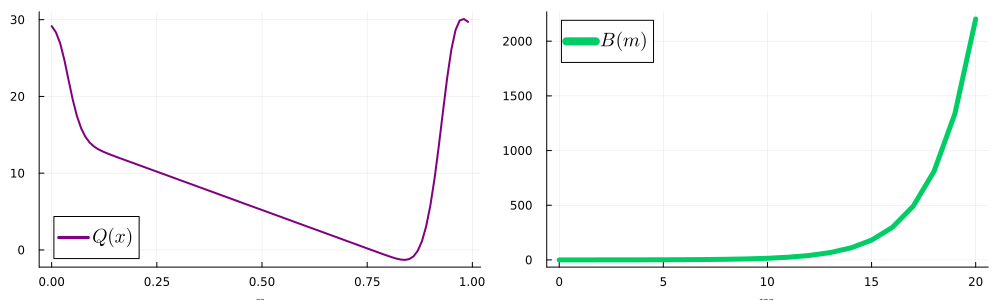

In [4]:
function Q_1(x)
    return 1/σ*exp(-(x-c)^2/σ^2) + 1/σ*exp(-(x - c +1)^2/σ^2)
end

function Q_2(x_vec, a, b, δ)
    base_vec = -a*x_vec .+ b
    return convolve(base_vec, ϕ_δ, x_vec, δ)
end


function Q(x_vec, a, b, δ)
    Q_1 = ((x) -> 1/σ*exp(-(x-c)^2/(4*σ^2)) + 1/σ*exp(-(x - c +1)^2/(4*σ^2))).(x_vec)
    base_vec = -a*x_vec .+ b
    Q_2 = convolve(base_vec, ϕ_δ, x_vec, δ)
    return Q_1 + Q_2
end


function ϕ_δ(x, δ) # kernel
    1/(δ* sqrt(2*π)) * exp(-x^2 / (2*δ^2))
end

function convolve(f_vec, ker, x_vec, δ)
    h = x_vec[2] - x_vec[1]
    N_h = length(x_vec)
    x_min = x_vec[1] - N_h
    x_max = x_vec[end] + N_h
    x_vec = x_min:h:x_max
    f_extension = [f_vec; f_vec; f_vec]
    result = Vector{Float64}(undef, 3*N_h)
    for j in 1:3*N_h
        result[j] = h*sum( [ f_extension[i] * ϕ_δ(x_vec[j] - x_vec[i], δ) for i in 1:3*N_h]) # * h
    end
    result = result[N_h:2*N_h - 1]
    return result
end

function B_inner(M, t_n) # congestion term
    return 1e-1exp.(0.5*M)
end

function B(M, t_n)
    return B2.(M)
end

function B2(M) # congestion term
    B_ = 0
    cutt = 50
    M < cutt ? B_ = B_inner(M, 0) : B_ = B_inner(cutt, 0)
    return B_
end


function F_h(M, x_vec, t_n)
    return C_B*B(M, 2 - t_n) + C_Q*Q(x_vec, a, b, δ)
end


using QuadGK
# m_T_func_unnorm = (x) -> exp(-50*(x-0.2)^2)
m_T_func_unnorm = (x) -> exp(-50*(x-0.2)^2) + exp(-50*(x+0.8)^2) 
oneOverC, error = quadgk(m_T_func_unnorm, 0, 1);

function m_T_func(x)
    return 1/oneOverC * m_T_func_unnorm(x) 
end

#constants
h=0.01
x_vec = 0:h:(1-h)
N_h = length(x_vec)
a=20 # linear convolution
b=15
δ = 0.02
c = 0.97 # gaussian
σ= 0.03
M_demo = 0:1:20

Q_vec = Q(x_vec, a, b, δ)

p1 = plot(x_vec, Q_vec, label=L"Q(x)", color=:purple, lw=2, xlabel=L"x", bottom_margin=1Plots.mm, size=(500, 300), legendfontsize=13, labelfontsize=13)
p2 = plot(M_demo, B.(M_demo, 0), label=L"B(m)", color=:springgreen3, lw=5,  xlabel=L"m", bottom_margin=1Plots.mm, size=(500, 300),  labelfontsize=13, legendfontsize=13)
plot(p1, p2, layout=2, size=(1000, 300))

#### Example 1 - No congestion cost  - example to demonstrate the motion towards the stage

In [5]:
## constants
α=1.5
h=0.01;
x_vec = 0:h:(1-h);
N_h =length(x_vec);
Δt = 0.005
t_vec = 0:Δt:(2-Δt)
N_T =length(t_vec)
ν= 0 #0.01
num_it_MFG=5 
num_it_HJB=5
R=10
C_B = 0
C_Q = 1
C_L = 70
C_H= 1/(C_L) # coeff before hamiltonian
C_G = 1
cv = (α, h, N_h, Δt, N_T, ν, num_it_MFG, num_it_HJB, x_vec, R); # create a constant-vector, to avoid clutter for all constants we need.


function G_h(M)
    return C_G*F_h(M, x_vec, 0)#C_G*ones(length(M))
end
function C_H_func(t)
    return C_H
end

#terminal condition
M_T =  m_T_func.(x_vec);


(U_mat, M_mat) = MFG_solve(M_T, cv);
M_mat = reverse(M_mat, dims=2);
U_mat = reverse(U_mat, dims=2);

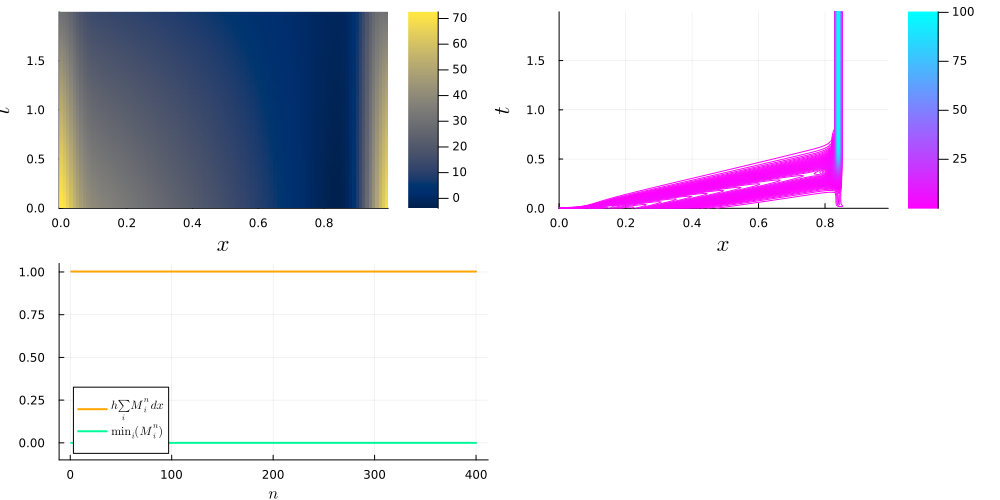

In [6]:
p1 = plot(x_vec, t_vec, U_mat', xlabel=L"x", ylabel=L"t", fig_layout="tight", color=:cividis, st=:heatmap,
labelfontsize=15, size=(500, 300))
p2 = plot(x_vec, t_vec, M_mat', xlabel=L"x", ylabel=L"t",  bottom_margin=1Plots.mm, levels=1000, labelfontsize=15,
color=cgrad(:cool, rev=true), size=(500, 300))
integration_m = [h*sum(M_mat'[i,:]) for i in 1:N_T];
min_val_m = [minimum(M_mat'[i,:]) for i in 1:N_T];
p3 = plot(integration_m, xlabel=L"n", label=L"h \sum_i M^n_i dx", ylim=(-0.1, 1.05), color=:orange, lw=2)
p3 = plot!(min_val_m, xlabel=L"n", label=L"\min_i(M_i^n)", color=:mediumspringgreen, lw=2)
plot(p1, p2, p3, layout=(2,2), size=(1000, 500))

#### Plotting velocity field
We compute the velocity field
$$
\alpha_t = - D_p H(x, t, Du)
$$

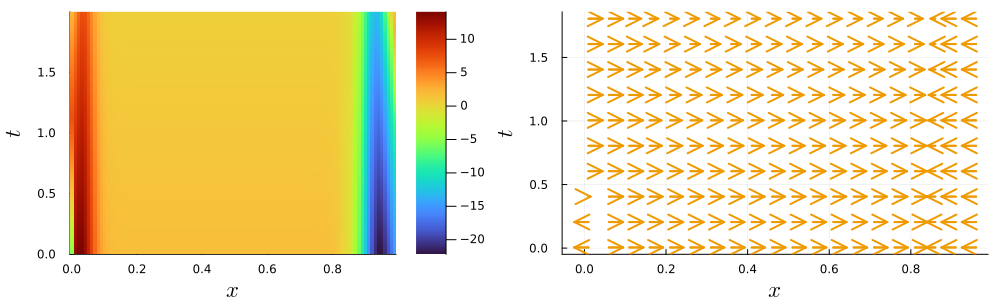

In [9]:
plot_vector_field(U_mat)

### Example 2 - with congestion cost and diffusion

In [10]:
using Plots, LaTeXStrings;
##
α=1.5
h=0.01;
x_vec = 0:h:(1-h);
N_h =length(x_vec);
Δt = 0.005
t_vec = 0:Δt:(2-Δt)
N_T =length(t_vec)
ν=0.1
num_it_MFG=5 
num_it_HJB=5
R=10
C_B = 1
C_Q = 0.1
C_L = 10
C_H= 1/(C_L) # coeff before hamiltonian
C_G = 0.5
cv = (α, h, N_h, Δt, N_T, ν, num_it_MFG, num_it_HJB, x_vec, R); # create a constant-vector, to avoid clutter for all constants we need.

#terminal condition
M_T =  m_T_func.(x_vec);


(U_mat, M_mat) = MFG_solve(M_T, cv);
M_mat = reverse(M_mat, dims=2);
U_mat = reverse(U_mat, dims=2);

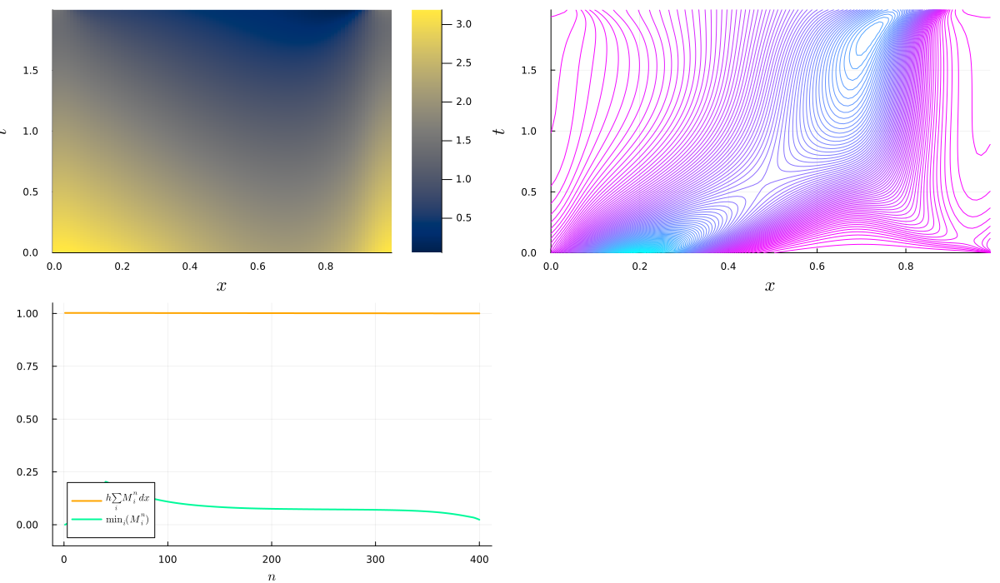

In [11]:
p1 = plot(x_vec, t_vec, U_mat', xlabel=L"x", ylabel=L"t", fig_layout="tight", st = :heatmap,  color=:cividis, 
labelfontsize=15, size=(500, 300))
p2 = plot(x_vec, t_vec, M_mat', xlabel=L"x", ylabel=L"t", bottom_margin=0Plots.mm, levels=100, labelfontsize=15, legend=false,
color=cgrad(:cool, rev=true), size=(500, 300), bbox_inches="tight", left_margin=0Plots.mm)
p3 = plot(x_vec, t_vec, M_mat', xlabel=L"x", ylabel=L"t",  bottom_margin=0Plots.mm, levels=200, labelfontsize=15, 
color=cgrad(:cool, rev=true), size=(500, 300), bbox_inches="tight", left_margin=0Plots.mm)
integration_m = [h*sum(M_mat'[i,:]) for i in 1:N_T];
min_val_m = [minimum(M_mat'[i,:]) for i in 1:N_T];
p3 = plot(integration_m, xlabel=L"n", label=L"h \sum_i M^n_i dx", ylim=(-0.1, 1.05), color=:orange, lw=2)
p3 = plot!(min_val_m, xlabel=L"n", label=L"\min_i(M_i^n)", color=:mediumspringgreen, lw=2)
plot(p1, p2, p3, layout=(2,2), size=(1200, 700))

#### Example 3 - High energy, high density festival

Create a time-dependent Hamiltonian, or rather $C_L=C_L(t) \propto C_H^{-1}$, to make it harder to move as time passes.
Models that more people are coming with increasing time, which reflects the incident at Astroworld in 2021.

A new congestion function $B(m)$, higher tolerance for high crowd density, right until the point of dangerous

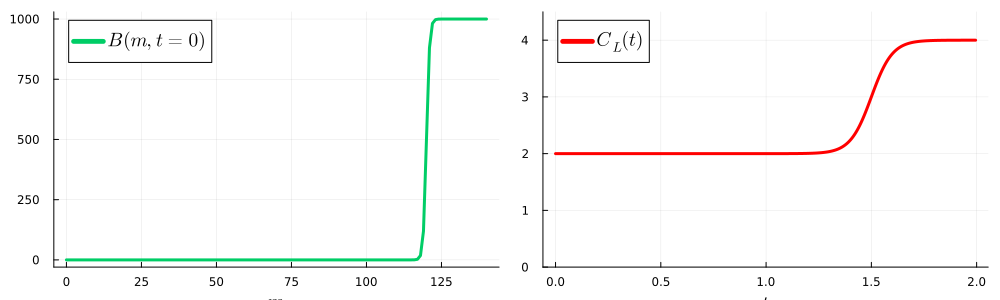

In [12]:
M_fatal = 120
Δ_Mfatal = 20
B_max = 1000
t_crit = 1.5# critical time when motion is hard
C_L0 = 2
ΔC_L = 2

function C_L_func(t)
    return C_L0 + ΔC_L / (1+ exp(-(t - t_crit)*20))
end

function B(M, t) # Change term
    return B_max ./ (1.0 .+ exp.(-(M.-M_fatal .+ Δ_Mfatal*t)*2))
end

M_demo = 0:1:140
p1 = plot(M_demo, B(M_demo, 0), label=L"B(m, t=0)", xlabel=L"m", color =:springgreen3, lw=3, bottom_margin=1Plots.mm, size=(500, 300), legendfontsize=13, labelfontsize=13)

p2 = plot(t_vec, C_L_func.(t_vec), label=L"C_L(t)", xlabel=L"t", color =:red, lw=3, bottom_margin=1Plots.mm, size=(500, 300), legendfontsize=13, labelfontsize=13, ylim=(0, 4.5))
plot(p1, p2, layout=2, size=(1000, 300))

Choose to view Scenario 1 or Scenario 2 by uncommenting one of the lines below.

In [23]:
################### CHOOSE SCENARIO 1 OR 2 BELOW BY UNCOMMENTING ONE OF THEM
# scenario = (0, 2) #scenario 1
scenario = (0.05, 1) #scenario 2
###################


using Plots, LaTeXStrings;

function C_L_func(t)
    return C_L0 + ΔC_L / (1+ exp(-(t - t_crit)*20))
end

function C_H_func(t)
    return 1/C_L_func(t)
end

function B(M, t) # Change term
    return B_max ./ (1.0 .+ exp.(-(M.-M_fatal .+ Δ_Mfatal*t)*2))
end

function F_h(M, x_vec, t_n)
    return C_B*B(M, 2 - t_n) + C_Q*Q(x_vec, a, b, δ)
end


α=1.8
h=0.01;
x_vec = 0:h:(1-h);
N_h =length(x_vec);
Δt = 0.005
t_vec = 0:Δt:(2-Δt)
N_T =length(t_vec)
ν= scenario[1]
num_it_MFG=5
num_it_HJB=5
R=10
C_B = 1
C_Q = 2
C_G = 0.5
M_fatal = 120
Δ_Mfatal = 40
B_max = 1000
t_crit = 1.5# critical time when motion is hard
C_L0 = 1
ΔC_L = scenario[2]
cv = (α, h, N_h, Δt, N_T, ν, num_it_MFG, num_it_HJB, x_vec, R); # create a constant-vector, to avoid clutter for all constants we need.

# terminal condition
M_T =  m_T_func.(x_vec);


(U_mat, M_mat) = MFG_solve(M_T, cv);
M_mat = reverse(M_mat, dims=2);
U_mat = reverse(U_mat, dims=2);

We define 
$$
|U^n|_{\infty, rel} =  \frac{\max_{i}|U^n_i|}{\max_{n}\max_{i}|U^n_i|}
$$

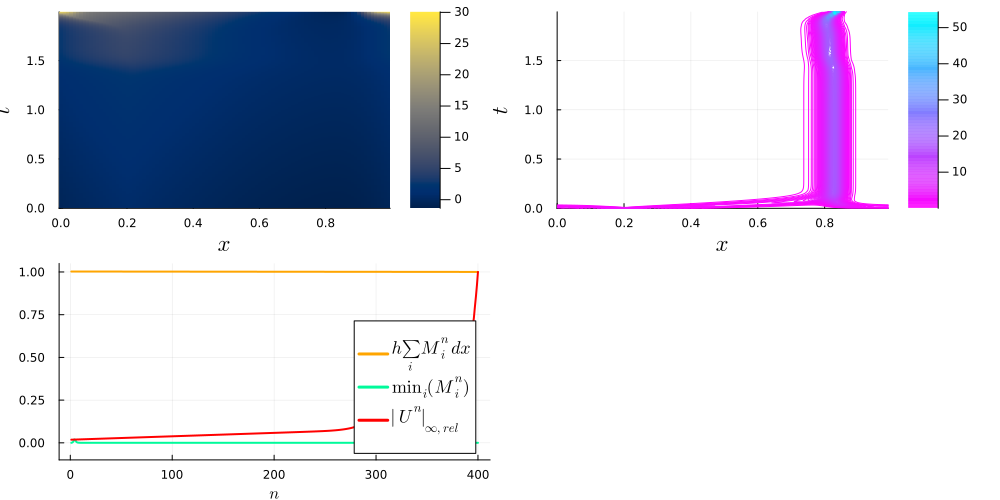

In [24]:
p1 = plot(x_vec, t_vec, U_mat', xlabel=L"x", ylabel=L"t", fig_layout="tight", st = :heatmap,  color=:cividis,
labelfontsize=15, size=(500, 300))
p2 = plot(x_vec, t_vec, M_mat', xlabel=L"x", ylabel=L"t", bottom_margin=0Plots.mm, levels=200, labelfontsize=15,
color=cgrad(:cool, rev=true), size=(500, 300), bbox_inches="tight", left_margin=0Plots.mm)
min_val_m = [minimum(M_mat'[i,:]) for i in 1:N_T];
max_val_u = [maximum(U_mat'[i,:]) for i in 1:N_T];
max_val_u ./= maximum(max_val_u)
p3 = plot(integration_m, xlabel=L"n", label=L"h \sum_i M^n_i dx", ylim=(-0.1, 1.05), color=:orange, lw=2)
p3 = plot!(min_val_m, xlabel=L"n", label=L"\min_i(M_i^n)", color=:mediumspringgreen, lw=2)
p3 = plot!(max_val_u, xlabel=L"n", label=L"\|U^n\|_{\infty, rel}", color=:red, lw=2, legendfontsize=12)
plot(p1, p2, p3, layout=(2,2), size=(1000, 500))